In [4]:
#First, we install all the required libraries and packages
import os
import glob
from tqdm import tqdm
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.io import wavfile
from python_speech_features import mfcc , logfbank
import librosa as lr
import os, glob, pickle
import librosa
from scipy import signal
import noisereduce as nr
from glob import glob
import librosa
%matplotlib inline
#All the Required Packages and Libraies are installed.
import soundfile
import tensorflow as tf
from tensorflow.keras.layers import Conv2D,MaxPool2D, Flatten, LSTM
from tensorflow.keras.layers import Dropout,Dense,TimeDistributed
from keras.models import Sequential
from keras.utils import to_categorical 
from sklearn.utils.class_weight import compute_class_weight
from sklearn.model_selection import train_test_split
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import accuracy_score

In [13]:
#We import the os module and zipfile module in python 
import os
import zipfile

# Defining  path to ZIP file and the directory to extract its contents
zip_file_path = 'ravdessnonextracted.zip' 
extract_to_dir = 'ravdess_extracted'

# Below , we check if the extracted directory exists, if not, we will create it-
if not os.path.exists(extract_to_dir):
    os.makedirs(extract_to_dir)

# We open the ZIP file below-
with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
    # Extract all the contents into the directory, using extractall method-
    zip_ref.extractall(extract_to_dir)

# Below , we list the contents of the directory-
def getListOfFiles(dirName):
    listOfFile = os.listdir(dirName)
    allFiles = list()
    # Iterating over all the entries-
    for entry in listOfFile:
        # We create a full path-
        fullPath = os.path.join(dirName, entry)
        # To ensure that if entry is a directory then get the list of files in this directory- 
        if os.path.isdir(fullPath):
            allFiles = allFiles + getListOfFiles(fullPath)
        else:
            allFiles.append(fullPath)
                
    return allFiles

# Use the above defined function to print a list all the files in the extracted directory-
list_of_files = getListOfFiles(extract_to_dir)
print(list_of_files)


['ravdess_extracted\\Actor_01\\03-01-01-01-01-01-01.wav', 'ravdess_extracted\\Actor_01\\03-01-01-01-01-02-01.wav', 'ravdess_extracted\\Actor_01\\03-01-01-01-02-01-01.wav', 'ravdess_extracted\\Actor_01\\03-01-01-01-02-02-01.wav', 'ravdess_extracted\\Actor_01\\03-01-02-01-01-01-01.wav', 'ravdess_extracted\\Actor_01\\03-01-02-01-01-02-01.wav', 'ravdess_extracted\\Actor_01\\03-01-02-01-02-01-01.wav', 'ravdess_extracted\\Actor_01\\03-01-02-01-02-02-01.wav', 'ravdess_extracted\\Actor_01\\03-01-02-02-01-01-01.wav', 'ravdess_extracted\\Actor_01\\03-01-02-02-01-02-01.wav', 'ravdess_extracted\\Actor_01\\03-01-02-02-02-01-01.wav', 'ravdess_extracted\\Actor_01\\03-01-02-02-02-02-01.wav', 'ravdess_extracted\\Actor_01\\03-01-03-01-01-01-01.wav', 'ravdess_extracted\\Actor_01\\03-01-03-01-01-02-01.wav', 'ravdess_extracted\\Actor_01\\03-01-03-01-02-01-01.wav', 'ravdess_extracted\\Actor_01\\03-01-03-01-02-02-01.wav', 'ravdess_extracted\\Actor_01\\03-01-03-02-01-01-01.wav', 'ravdess_extracted\\Actor_01\\

In [4]:
#We import the speech-recogntion module to get the Raw Text from Audio Files.
#Although Speech Recognition is weaker for large chunk of files , so useing Error Handling , where when it is not be able to 
#produce the text of a particular Audio File it prints the statement 'error'.

import speech_recognition as sr

r = sr.Recognizer()
for file in list_of_files:  # Correct variable name
    with sr.AudioFile(file) as source:
        audio = r.listen(source)
        try:
            text = r.recognize_google(audio)
            print(text)
        except:
            print('error')


can you talking by the door
can you talking by the door
talk to sitting by the door
talk to Siri by the door
kids talking by the door
kids talking by the door
talk to sitting by the door
dogs are sitting by the door
can you talking by the door
kids are talking by the door
dogs are sitting by the door
dogs are sitting by the door
can you talking by the door
kids talking by the door
dogs are sitting by the door
dogs are sitting by the door
kids talking by the door
kids are talking by the door
dogs are sitting by the door
dogs are sitting by the door
kids are talking by the door
kids are talking by the door
talk to sitting by the door
doctor sitting by the door
kids are talking by the door
kids are talking by the door
dogs are sitting by the door
dogs are sitting by the door
kids are talking by the door
kids are talking by the door
dogs are sitting by the door
dogs are sitting by the door
kids are talking by the door
screenshot talking by the door
dogs are sitting by the door
stocks are s

In [16]:
#Now cleaning is performed where:
#DOWN SAMPLING OF AUDIO FILES IS DONE  AND  MASK IS PUT OVER IT AND DIRECT INTO CLEAN FOLDER
#MASK IS TO REMOVE UNNECESSARY EMPTY VOICES AROUND THE MAIN AUDIO VOICE 
def envelope(y , rate, threshold):
    mask=[]
    y=pd.Series(y).apply(np.abs)
    y_mean = y.rolling(window=int(rate/10) ,  min_periods=1 , center = True).mean()
    for mean in y_mean:
        if mean>threshold:
            mask.append(True)
        else:
            mask.append(False)
    return mask

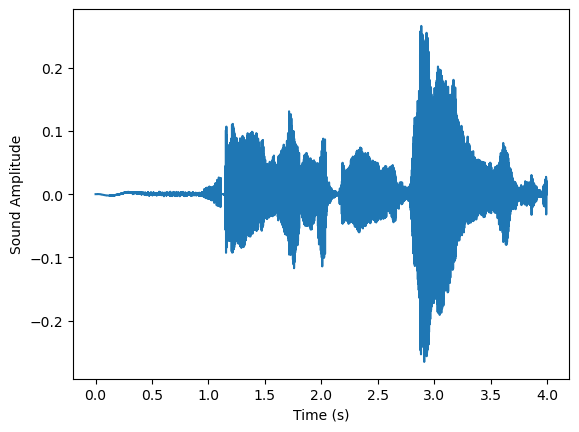

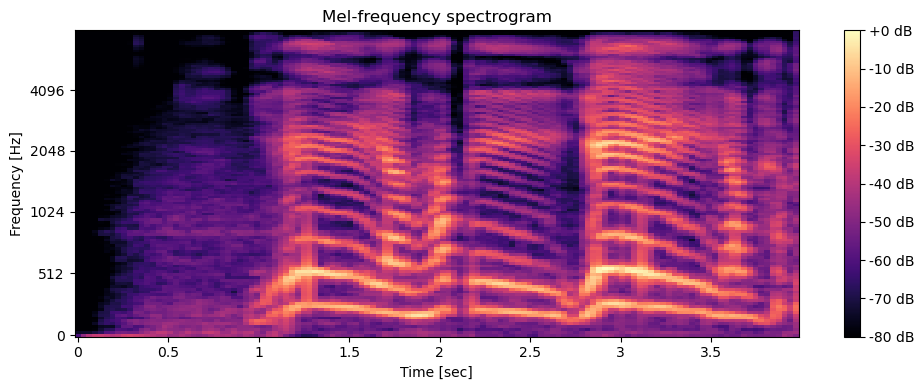

In [17]:
import matplotlib.pyplot as plt
import numpy as np
import librosa as lr

#The audio file is downloaded for handling -
audio, sfreq = lr.load(file, sr=16000)  #It is downsampled to 16 kHz.
time = np.arange(0, len(audio)) / sfreq

# The waveform is plotted.
fig, ax = plt.subplots()
ax.plot(time, audio)
ax.set(xlabel='Time (s)', ylabel='Sound Amplitude')
plt.show()

# Calculate the spectrogram using librosa.feature.melspectrogram for n even more robust approach-
S = lr.feature.melspectrogram(y=audio, sr=sfreq, n_mels=128, fmax=8000)
# Convert to log scale (dB). We use power_to_db to convert the amplitude spectrogram to dB, which is a more useful scale-
S_dB = lr.power_to_db(S, ref=np.max)

# We plot the spectrogram-
plt.figure(figsize=(10, 4))
lr.display.specshow(S_dB, sr=sfreq, x_axis='time', y_axis='mel', fmax=8000, cmap='magma')
plt.colorbar(format='%+2.0f dB')
plt.title('Mel-frequency spectrogram')
plt.tight_layout()
plt.ylabel('Frequency [Hz]')
plt.xlabel('Time [sec]')
plt.show()


In [26]:
#The next step is In-Depth Visualisation of Audio Files and its certain features to plot for.
#Then,they are plotting Functions to be called later. 
def plot_signals(signals):
    fig , axes = plt.subplots(nrows=2, ncols=5,sharex =False , sharey=True, figsize=(20,5))
    fig.suptitle('Time Series' , size=16)
    i=0
    for x in range(2):
        for y in range(5):
            axes[x,y].set_title(list(signals.keys())[i])
            axes[x,y].plot(list(signals.values())[i])
            axes[x,y].get_xaxis().set_visible(False)
            axes[x,y].get_yaxis().set_visible(False)
            i +=1

def plot_fft(fft):
    fig , axes = plt.subplots(nrows=2, ncols=5,sharex =False , sharey=True, figsize=(20,5))
    fig.suptitle('Fourier Transform' , size=16)
    i=0
    for x in range(2):
        for y in range(5):
            data = list(fft.values())[i]
            Y,freq = data[0] , data[1]
            axes[x,y].set_title(list(fft.keys())[i])
            axes[x,y].plot(freq , Y)
            axes[x,y].get_xaxis().set_visible(False)
            axes[x,y].get_yaxis().set_visible(False)
            i +=1
    
def plot_fbank(fbank):
    fig , axes = plt.subplots(nrows=2, ncols=5,sharex =False , sharey=True, figsize=(20,5))
    fig.suptitle('Filter Bank Coefficients' , size=16)
    i=0
    for x in range(2):
        for y in range(5):
            axes[x,y].set_title(list(fbank.keys())[i])
            axes[x,y].imshow(list(fbank.values())[i],cmap='hot', interpolation = 'nearest')
            axes[x,y].get_xaxis().set_visible(False)
            axes[x,y].get_yaxis().set_visible(False)
            i +=1
            
def plot_mfccs(mfccs):
    fig , axes = plt.subplots(nrows=2, ncols=5,sharex =False , sharey=True, figsize=(20,5))
    fig.suptitle('Mel Frequency Capstrum  Coefficients' , size=16)
    i=0
    for x in range(2):
        for y in range(5):
            axes[x,y].set_title(list(mfccs.keys())[i])
            axes[x,y].imshow(list(mfccs.values())[i],
                             cmap='hot', interpolation = 'nearest')
            axes[x,y].get_xaxis().set_visible(False)
            axes[x,y].get_yaxis().set_visible(False)
            i +=1

def calc_fft(y,rate):
    n = len(y)
    freq = np.fft.rfftfreq(n , d= 1/rate)
    Y= abs(np.fft.rfft(y)/n)
    return(Y,freq)

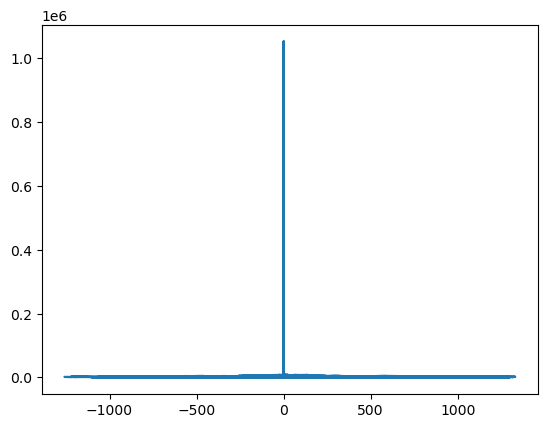

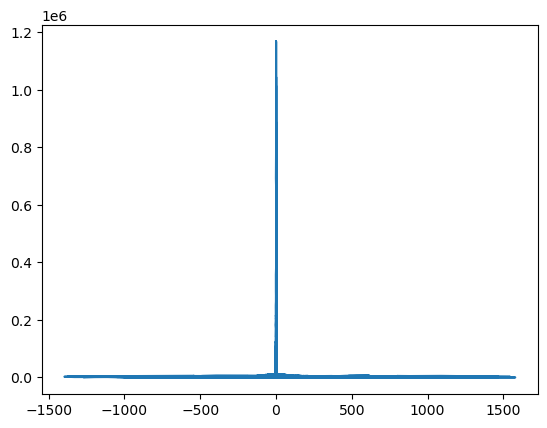

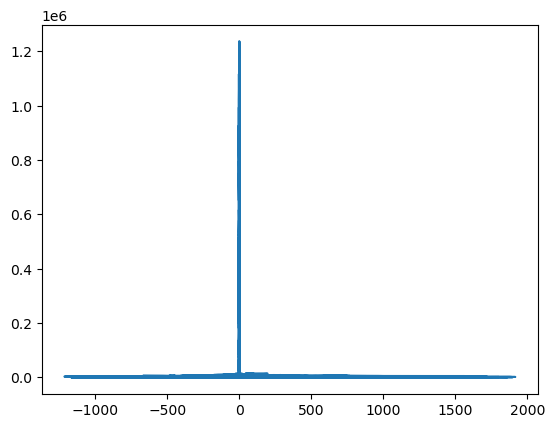

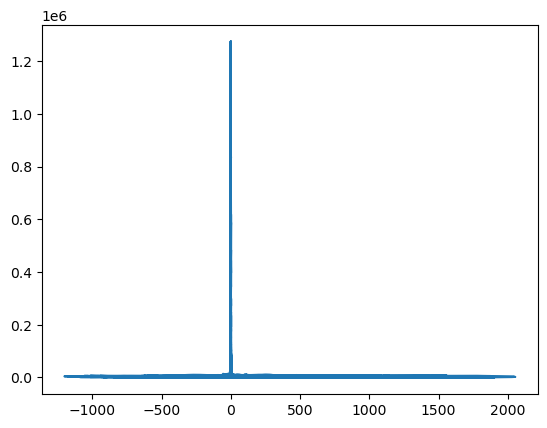

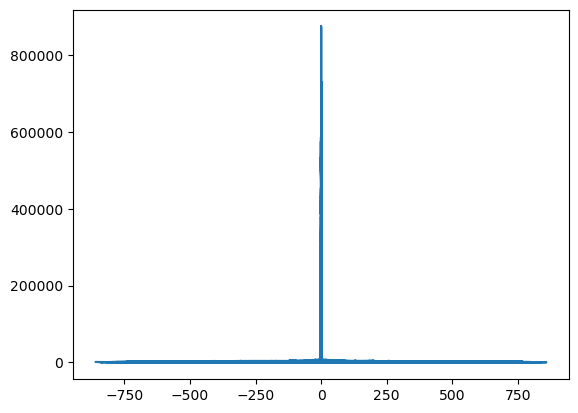

...

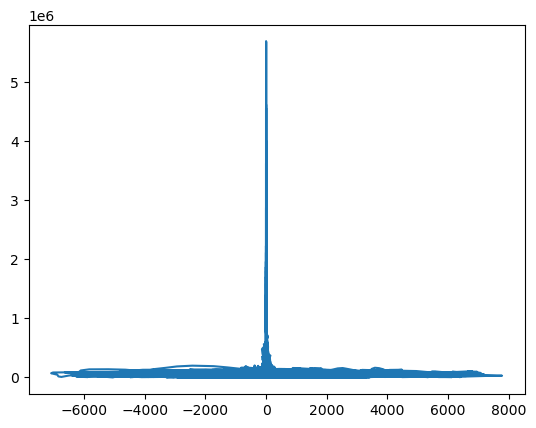

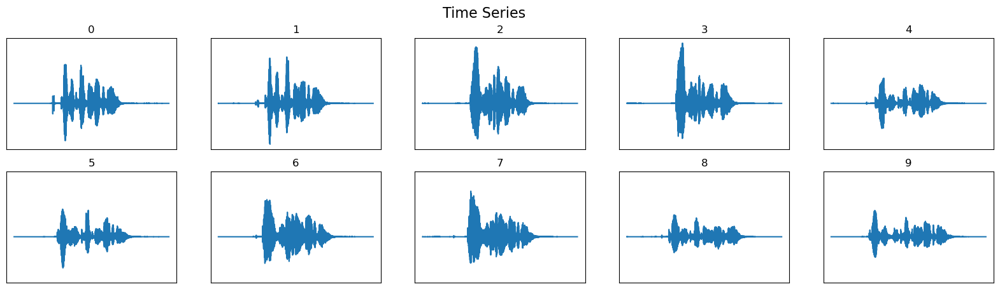

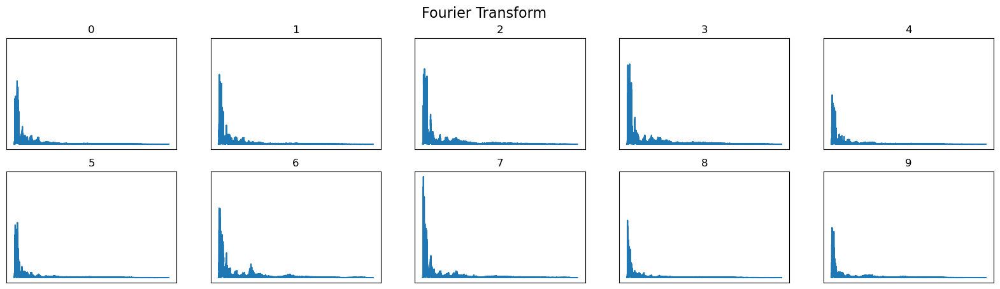

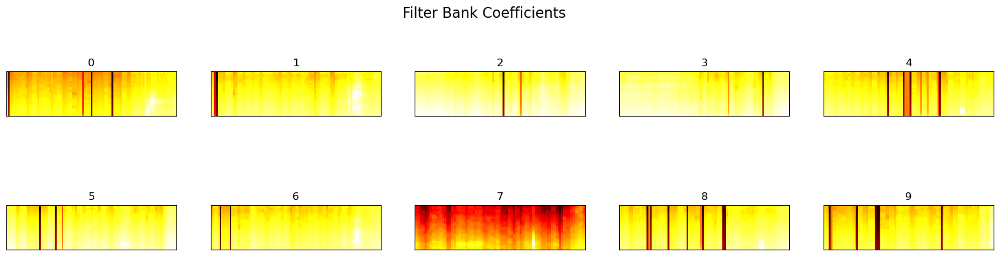

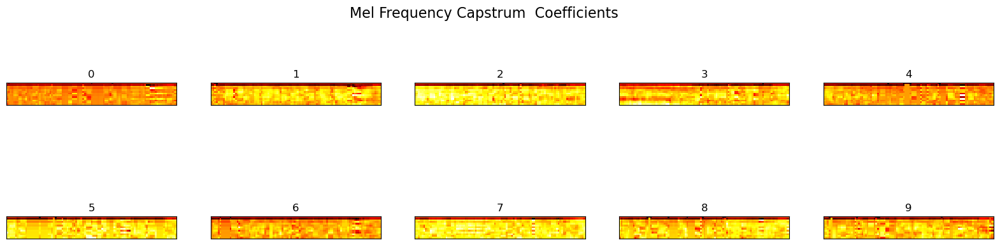

In [9]:
#We import the required modules.
import warnings
from scipy.io import wavfile as wav

#WavFileWarning is suppressed-
warnings.filterwarnings('ignore', category=wav.WavFileWarning)

#Code for processing WAV files-
for file in range(0, len(list_of_files), 1):
    rate, data = wav.read(list_of_files[file])



# Here The Data Set is loaded and plots are Visualised by Calling the Plotting Functions . 
import matplotlib.pyplot as plt
from scipy.io import wavfile as wav
from scipy.fftpack import fft
import numpy as np
for file in range(0 , len(list_of_files) , 1):
    rate, data = wav.read(list_of_files[file])
    fft_out = fft(data)
    %matplotlib inline
    plt.plot(data, np.abs(fft_out))
    plt.show()
    
signals={}
fft={}
fbank={}
mfccs={}
# load data
for file in range(0 , len(list_of_files) , 1):
#     rate, data = wavfile.read(list_of_files[file])
     signal,rate =librosa.load(list_of_files[file] , sr=44100)
     mask = envelope(signal , rate , 0.0005)
     signals[file] = signal
     fft[file] = calc_fft(signal , rate)
    
     bank = logfbank(signal[:rate] , rate , nfilt = 26, nfft = 1103).T
     fbank[file] = bank
     mel = mfcc(signal[:rate] , rate , numcep =13 , nfilt = 26 , nfft=1103).T
     mfccs[file]=mel

plot_signals(signals)
plt.show()

plot_fft(fft)
plt.show()

plot_fbank(fbank)
plt.show()

plot_mfccs(mfccs)
plt.show()

In [18]:
#Again the definition of envelope is repeated for masking the audio files - 
def envelope(y , rate, threshold):
    mask=[]
    y=pd.Series(y).apply(np.abs)
    y_mean = y.rolling(window=int(rate/10) ,  min_periods=1 , center = True).mean()
    for mean in y_mean:
        if mean>threshold:
            mask.append(True)
        else:
            mask.append(False)
    return mask

In [19]:
#Clean Audio Files are redirected to Clean Audio Folder Directory- 
import glob,pickle
for file in tqdm(glob.glob(r'C:\Users\nahso\OneDrive\Desktop\ML2\ravdessnonextracted\\**\\*.wav')):
    file_name = os.path.basename(file)
    signal , rate = librosa.load(file, sr=16000)
    mask = envelope(signal,rate, 0.0005)
    wavfile.write(filename= r'C:\Users\nahso\OneDrive\Desktop\ML2\CLEANSPEECH\\'+str(file_name), rate=rate,data=signal[mask])

100%|██████████████████████████████████████████████████████████████████████████████| 1440/1440 [01:04<00:00, 22.18it/s]


In [2]:
#The extract feature function is used to extract the required features and return the array as a result-

def extract_feature(file_name, mfcc, chroma, mel):
    X, sample_rate = librosa.load(file_name, sr=None, mono=True)
    
    result = []
    
    if mfcc:
        mfccs = librosa.feature.mfcc(y=X, sr=sample_rate, n_mfcc=40)
        mfccs_mean = np.mean(mfccs, axis=1)  # Note the axis change here
        result.extend(mfccs_mean)
    
    if chroma:
        stft = np.abs(librosa.stft(X))
        chroma = librosa.feature.chroma_stft(S=stft, sr=sample_rate)
        chroma_mean = np.mean(chroma, axis=1)  # Note the axis change here
        result.extend(chroma_mean)
    
    if mel:
        mel = librosa.feature.melspectrogram(y=X, sr=sample_rate)
        mel_mean = np.mean(mel, axis=1)  # Note the axis change here
        result.extend(mel_mean)
    
    return np.array(result)




In [14]:
#Emotions that are in the RAVDESS dataset to be classify Audio Files as 
emotions={
  '01':'neutral',
  '02':'calm',
  '03':'happy',
  '04':'sad',
  '05':'angry',
  '06':'fearful',
  '07':'disgust',
  '08':'surprised'
}
#These are the more commonly observed emotions:
observed_emotions=['calm', 'happy', 'fearful', 'disgust']

In [11]:
#Load the data and extract features for each sound file -
from glob import glob
import os
import glob
def load_data(test_size=0.33):
    x,y=[],[]
    answer = 0
    for file in glob.glob(r'C:\Users\nahso\OneDrive\Desktop\ML2\CLEANSPEECH\\*.wav'):
        file_name=os.path.basename(file)
        emotion=emotions[file_name.split("-")[2]]
        if emotion not in observed_emotions:
            answer += 1
            continue
        feature=extract_feature(file, mfcc=True, chroma=True, mel=True)
        x.append(feature)
        y.append([emotion,file_name])
    return train_test_split(np.array(x), y, test_size=test_size, random_state=9)

In [22]:
pip install librosa soundfile tensorflow


Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.


In [15]:
#The dataset is split as training set and testing set -
import librosa
import numpy as np
x_train,x_test,y_trai,y_tes=load_data(test_size=0.25)
print(np.shape(x_train),np.shape(x_test), np.shape(y_trai),np.shape(y_tes))
y_test_map = np.array(y_tes).T
y_test = y_test_map[0]
test_filename = y_test_map[1]
y_train_map = np.array(y_trai).T
y_train = y_train_map[0]
train_filename = y_train_map[1]
print(np.shape(y_train),np.shape(y_test))
print(*test_filename,sep="\n")

(576, 180) (192, 180) (576, 2) (192, 2)
(576,) (192,)
03-01-06-01-02-02-01.wav
03-01-03-01-02-01-21.wav
03-01-07-01-02-02-04.wav
03-01-02-02-01-02-24.wav
03-01-07-01-02-02-19.wav
03-01-06-01-01-01-07.wav
03-01-07-01-01-01-16.wav
03-01-02-01-02-02-06.wav
03-01-06-01-01-02-07.wav
03-01-06-02-01-01-15.wav
03-01-02-02-02-02-07.wav
03-01-06-01-02-02-19.wav
03-01-06-02-02-02-05.wav
03-01-06-01-01-01-14.wav
03-01-06-01-02-01-15.wav
03-01-03-02-02-01-06.wav
03-01-02-01-01-02-16.wav
03-01-07-01-01-01-13.wav
03-01-03-02-02-02-24.wav
03-01-02-01-02-02-19.wav
03-01-02-02-01-02-09.wav
03-01-02-01-01-02-07.wav
03-01-03-01-02-01-13.wav
03-01-02-01-02-01-18.wav
03-01-02-02-02-02-03.wav
03-01-02-02-01-01-11.wav
03-01-03-01-02-02-20.wav
03-01-03-02-01-02-06.wav
03-01-06-01-01-02-11.wav
03-01-03-01-02-01-18.wav
03-01-06-01-01-01-15.wav
03-01-07-02-01-02-08.wav
03-01-07-02-01-02-23.wav
03-01-03-01-02-02-10.wav
03-01-06-01-01-01-23.wav
03-01-07-02-02-01-18.wav
03-01-06-02-02-01-22.wav
03-01-07-02-01-01-21.

In [29]:
#Then , we get the shape of the train set and the test set -
print((x_train[0], x_test[0]))
#Get the number of features extracted
print(f'Features extracted: {x_train.shape[1]}')

(array([-4.72885620e+02,  6.39674339e+01,  6.17852736e+00,  2.27891064e+01,
       -1.86483326e+01, -8.30456352e+00, -8.13572502e+00, -2.66228986e+00,
       -4.45510054e+00,  9.47255993e+00, -1.61330318e+00, -3.86304593e+00,
       -1.10218787e+00,  1.76132500e+00, -7.75962210e+00,  1.50661111e-01,
       -6.32133055e+00,  1.81471437e-01, -7.18594980e+00, -5.14388180e+00,
       -5.48315763e+00, -9.95529115e-01, -5.72346306e+00, -2.46393785e-01,
       -9.73914814e+00,  5.95409870e+00, -2.98389220e+00,  1.60116780e+00,
       -3.14024329e+00, -9.41481829e-01, -7.19789267e-01,  9.47594821e-01,
       -6.14695835e+00, -3.49499559e+00, -8.83763695e+00, -2.88523197e+00,
       -1.58497643e+00, -8.23680460e-01, -6.02904701e+00, -3.92877316e+00,
        6.35040581e-01,  6.21833503e-01,  6.67138040e-01,  6.82644427e-01,
        7.42090583e-01,  7.68841267e-01,  7.01759040e-01,  6.63775206e-01,
        7.31715858e-01,  6.89814746e-01,  6.42361820e-01,  6.52536094e-01,
        3.14068631e-04, 

In [17]:
# Initialize the Multi Layer Perceptron Classifier(MLP Classifier for classsification )-
model=MLPClassifier(alpha=0.01, batch_size=256, epsilon=1e-08, hidden_layer_sizes=(300,), learning_rate='adaptive', max_iter=500)

In [18]:
#The model is trained through the fit method-
model.fit(x_train,y_train)

MLPClassifier(alpha=0.01, batch_size=256, hidden_layer_sizes=(300,),
              learning_rate='adaptive', max_iter=500)

In [22]:
#Now, we save the model-
import pickle
# Save the Model to file in the current working directory ,for any new testing data other than the data in dataset-

Pkl_Filename = "Emotion_Voice_Detection_Model_NEW.pkl"  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(model, file)

In [23]:
# The model is loaded back from the file -
with open(Pkl_Filename, 'rb') as file:  
    Emotion_Voice_Detection_Model_NEW = pickle.load(file)

Emotion_Voice_Detection_Model_NEW

MLPClassifier(alpha=0.01, batch_size=256, hidden_layer_sizes=(300,),
              learning_rate='adaptive', max_iter=500)

In [24]:
# Prediction is done on the test set:
y_pred=Emotion_Voice_Detection_Model_NEW.predict(x_test)
y_pred

array(['fearful', 'happy', 'fearful', 'calm', 'disgust', 'calm',
       'disgust', 'disgust', 'fearful', 'fearful', 'calm', 'fearful',
       'happy', 'fearful', 'fearful', 'happy', 'calm', 'disgust',
       'fearful', 'calm', 'calm', 'calm', 'happy', 'calm', 'calm', 'calm',
       'happy', 'happy', 'disgust', 'calm', 'disgust', 'disgust',
       'disgust', 'happy', 'fearful', 'disgust', 'fearful', 'disgust',
       'happy', 'fearful', 'disgust', 'calm', 'happy', 'fearful',
       'fearful', 'calm', 'fearful', 'calm', 'calm', 'calm', 'happy',
       'happy', 'happy', 'calm', 'disgust', 'disgust', 'disgust', 'happy',
       'happy', 'calm', 'calm', 'happy', 'disgust', 'fearful', 'calm',
       'happy', 'disgust', 'happy', 'fearful', 'fearful', 'fearful',
       'calm', 'calm', 'calm', 'fearful', 'calm', 'disgust', 'fearful',
       'happy', 'disgust', 'fearful', 'happy', 'fearful', 'fearful',
       'disgust', 'fearful', 'happy', 'disgust', 'disgust', 'fearful',
       'calm', 'fearful'

In [30]:
#Store the Prediction probabilities into a CSV file -
import numpy as np
import pandas as pd
y_pred1 = pd.DataFrame(y_pred, columns=['predictions'])
y_pred1['file_names'] = test_filename
print(y_pred1)
y_pred1.to_csv('predictionfinal.csv')

    predictions                file_names
0       disgust  03-01-06-01-02-02-01.wav
1         happy  03-01-03-01-02-01-21.wav
2       fearful  03-01-07-01-02-02-04.wav
3          calm  03-01-02-02-01-02-24.wav
4       disgust  03-01-07-01-02-02-19.wav
..          ...                       ...
187     disgust  03-01-07-01-02-02-14.wav
188       happy  03-01-03-02-02-02-02.wav
189       happy  03-01-06-02-01-01-14.wav
190     disgust  03-01-07-01-01-02-02.wav
191     disgust  03-01-02-02-02-01-22.wav

[192 rows x 2 columns]


In [32]:
#To record audio using a microphone :
import pyaudio
import wave

CHUNK = 1024 
FORMAT = pyaudio.paInt16 #paInt8
CHANNELS = 2 #split into 2 channels -
RATE = 44100 #sample rate
RECORD_SECONDS = 4
WAVE_OUTPUT_FILENAME = "output10.wav"

p = pyaudio.PyAudio()

stream = p.open(format=FORMAT,
                channels=CHANNELS,
                rate=RATE,
                input=True,
                frames_per_buffer=CHUNK) #

print("* recording")
frames = []

for i in range(0, int(RATE / CHUNK * RECORD_SECONDS)):
    data = stream.read(CHUNK)
    frames.append(data) # 2 bytes(16 bits) per channel

print("* done recording")

stream.stop_stream()
stream.close()
p.terminate()

wf = wave.open(WAVE_OUTPUT_FILENAME, 'wb')
wf.setnchannels(CHANNELS)
wf.setsampwidth(p.get_sample_size(FORMAT))
wf.setframerate(RATE)
wf.writeframes(b''.join(frames))
wf.close()

* recording
* done recording


In [38]:
pip install librosa --upgrade
#Just to ensure that the required librosa package is there , we update it .

Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.


In [30]:
#We test the extract feature function.
file = 'output10.wav'
new_feature = extract_feature(file, mfcc=True, chroma=True, mel=True)
print("New feature shape:", new_feature.shape)

# Prediction by the model is performed-
prediction = Emotion_Voice_Detection_Model_NEW.predict([new_feature])
print("Prediction Of the Emotion is :",prediction[0])


New feature shape: (180,)
Prediction Of the Emotion is : disgust
